In [1]:
from pygel3d import hmesh, jupyter_display as jd, gl_display as gl, graph
import numpy as np
import math
from commons.utils import *
from commons.display import *
from medial_axis_processing import unfolding, inverse_apply, preprocessing
from medial_axis_processing.medial_axis import *
from scipy.spatial import KDTree

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
input_mesh_path = '../data/x19_rough_center.ply'

input_mesh = hmesh.load(input_mesh_path)

In [7]:
file_path = "../pipeline/medial_sheet_coin.obj"
medial_sheet = hmesh.load(file_path)
medial_curves = []

In [8]:
jd.display(medial_sheet)

FigureWidget({
    'data': [{'color': '#dddddd',
              'flatshading': False,
              'i': array([   0,    3,    6, ..., 2114, 2117,  440]),
              'j': array([   1,    4,    7, ..., 2115, 2118, 2120]),
              'k': array([   2,    5,    8, ..., 2116, 2119, 2096]),
              'type': 'mesh3d',
              'uid': '180bc16f-75b2-4eff-9159-3b148a026d9b',
              'x': array([12.70784764, 15.815676  , 15.39016121, ...,  9.90873106,  8.29434569,
                           9.90873106]),
              'y': array([-16.78937061, -17.64795489, -20.30024846, ...,  34.22383419,
                           33.96075512,  34.22383419]),
              'z': array([-5.40232877, -5.13171438, -6.24162821, ..., 12.97528084, 11.32274835,
                          12.97528084])},
             {'hoverinfo': 'none',
              'line': {'color': 'rgb(125,0,0)', 'width': 1},
              'mode': 'lines',
              'type': 'scatter3d',
              'uid': '66f2b489-f50d

In [8]:
vertices = 
correspondences = build_ball_correspondences(input_mesh, vertices)

NameError: name 'vertices' is not defined

In [13]:
medial_axis = MedialAxis(input_mesh, vertices, medial_sheet, medial_curves, correspondences)

In [14]:
# display_medial_axis(medial_axis)

In [15]:
unfolded_sheet = unfolding.get_unfolded_sheet_positions(medial_axis)
unfolded_curves = unfolding.get_unfolded_curve_positions(medial_axis, medial_sheet.positions(), unfolded_sheet)

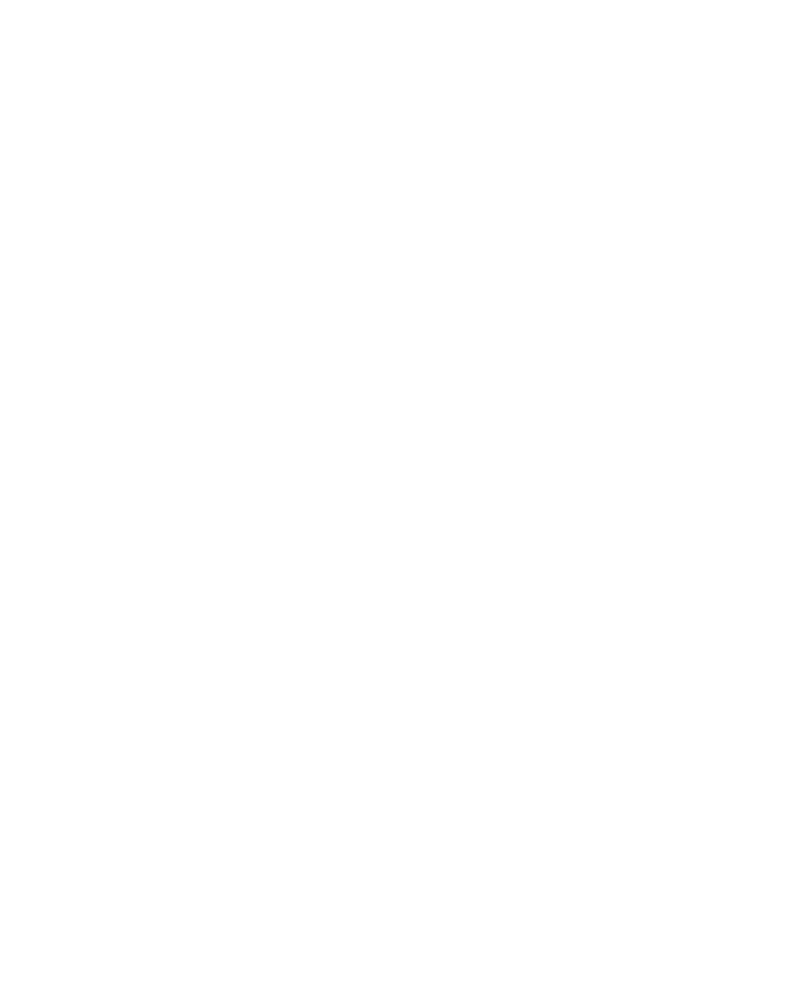

In [21]:
display_mesh(medial_axis.sheet, color="#ffffff")

In [16]:
inverse_apply.apply_inverse_medial_axis_transform(input_mesh, medial_axis, unfolded_sheet, unfolded_curves)

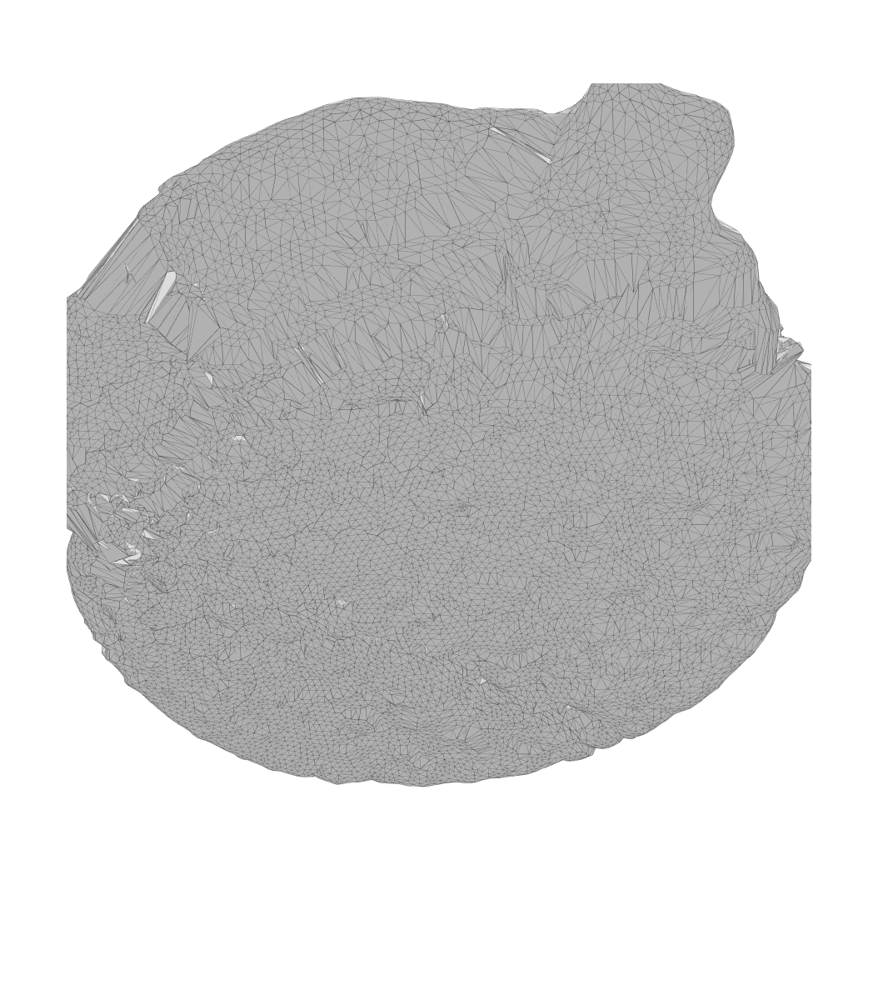

In [17]:
display_mesh(input_mesh)